In [1]:
import stt as st
import scanpy as sc
import cellrank as cr

adata = cr.datasets.pancreas()


/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/pyemma/__init__.py:92: UserWarning: You are not using the latest release of PyEMMA. Latest is 2.5.7, you have 2.5.6.
  .format(latest=latest, current=current), category=UserWarning)


In [17]:
import scvelo as scv
scv.pp.filter_and_normalize(
    adata, min_shared_counts=20, n_top_genes=2000
)

Filtered out 219 genes that are detected 20 counts (shared).
Extracted 2000 highly variable genes.


In [19]:
scv.pp.moments(adata)

computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [28]:
adata.obs['attractor']=adata.obs['clusters']
adata_aggr = st.tl.dynamical_iteration(adata,n_states =8, n_iter = 20, n_neighbors = 25, n_components = 21, weight_connectivities=0.5, monitor_mode=False)


Quantiles for entropy relative difference with last iteration:
0.00   NaN
0.25   NaN
0.50   NaN
0.75   NaN
1.00   NaN
dtype: float64

Quantiles for entropy absolute difference with last iteration:
0.00    0.467179
0.25    1.219063
0.50    1.399593
0.75    1.683602
1.00    1.915969
dtype: float64

Quantiles for entropy relative difference with last iteration:
0.00    0.000099
0.25    0.049475
0.50    0.094448
0.75    0.139769
1.00    1.495038
dtype: float64

Quantiles for entropy absolute difference with last iteration:
0.00    0.000113
0.25    0.068246
0.50    0.128728
0.75    0.207018
1.00    0.721859
dtype: float64

Quantiles for entropy relative difference with last iteration:
0.00    0.000017
0.25    0.013997
0.50    0.030352
0.75    0.052841
1.00    0.196132
dtype: float64

Quantiles for entropy absolute difference with last iteration:
0.00    0.000024
0.25    0.018909
0.50    0.042698
0.75    0.073949
1.00    0.268610
dtype: float64
Entropy difference is below the threshold, exi

/Users/cliffzhou/Documents/GitHub/STT/example_notebooks/stt/tl/_dynamical_analysis.py:338: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  sc_object_aggr.obs['entropy'] = adata.obs['entropy'].values


In [9]:
sc.set_figure_params(dpi=600,fontsize = 12)
sc.pl.embedding(adata,color = ['clusters','attractor','speed','entropy'],basis = 'umap',legend_fontsize = 10)

In [ ]:
adata_aggr.obsm['X_umap'] = adata.obsm['X_umap']
scv.tl.velocity_graph(adata_aggr,n_jobs=-1,vkey = 'vj')

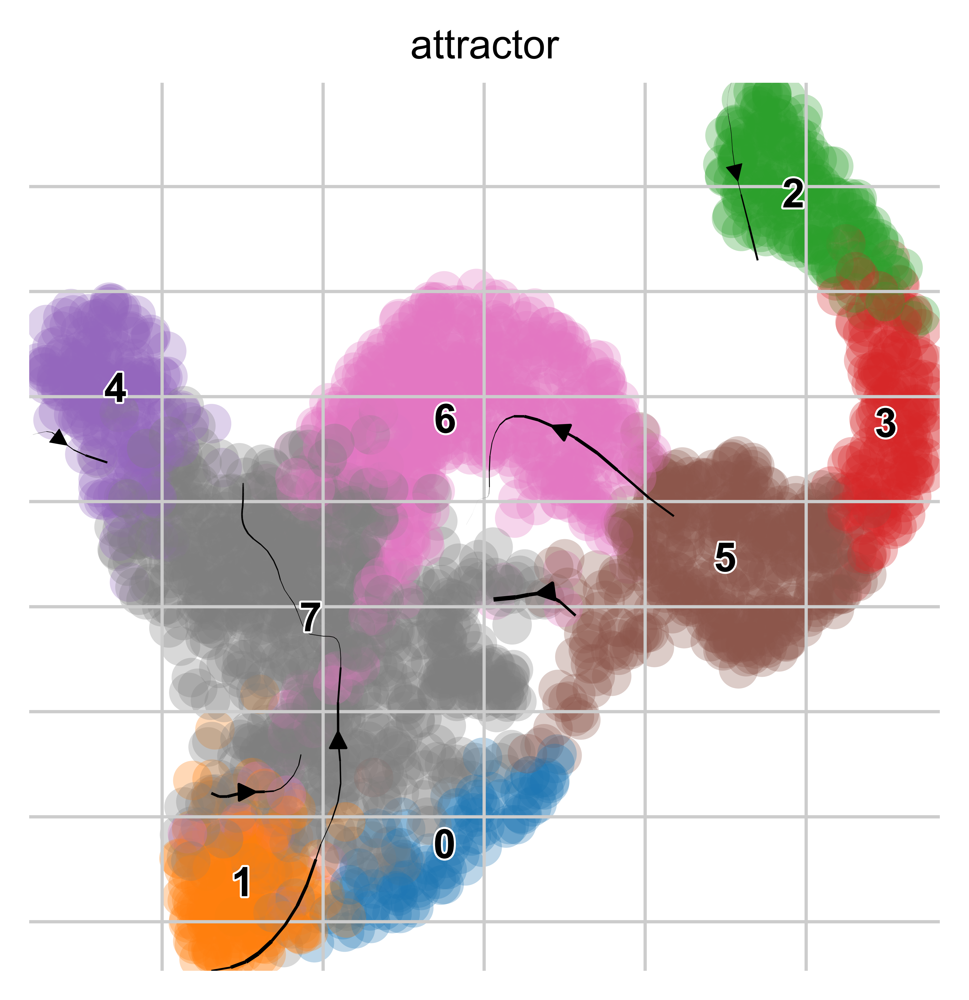

In [57]:
scv.pl.velocity_embedding_stream(adata_aggr, basis='umap', color='attractor',vkey = 'vj',density = 0.2)

In [10]:
import matplotlib.pyplot as plt
sc.set_figure_params(dpi=600,fontsize = 10)
adata.obsm['X_umap_aggr']=adata_aggr.obsm['X_umap']
st.pl.plot_tensor(adata, adata_aggr, list_attractor = [0,1,4],basis = 'umap',filter_cells = True, member_thresh = 0.1, density = 0.5)
plt.savefig('pancreas_tensor.png')

check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:07) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:05) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
computing velocity graph (using 8/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res
/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


    finished (0:00:05) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/2531 [00:00<?, ?cells/s]

/Users/cliffzhou/anaconda3/envs/stt/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)


  0%|          | 0/100 [00:00<?, ?sim/s]

[0]PETSC ERROR: ------------------------------------------------------------------------


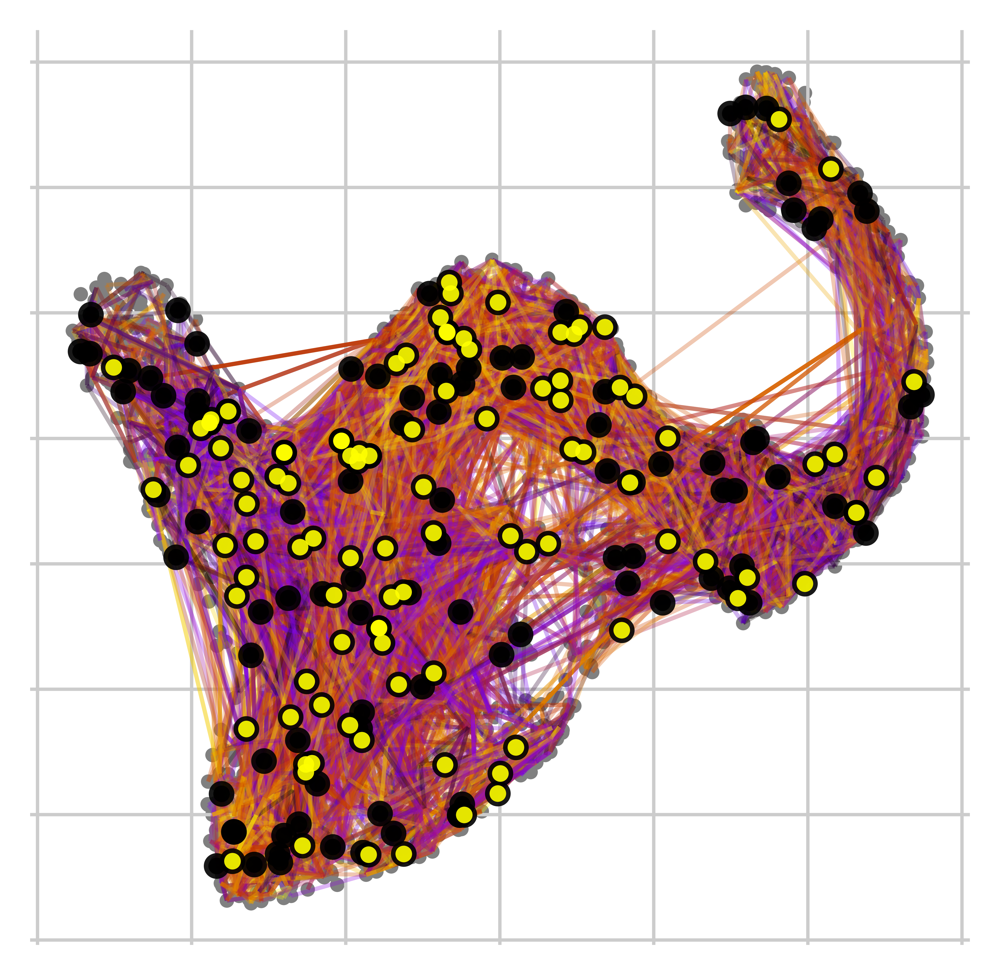

In [40]:
kernel = adata.uns['kernel']
kernel.adata.obsm['X_umap'] = adata_aggr.obsm['X_umap']
kernel.plot_random_walks(n_sims=100,basis='umap',max_iter=200,n_jobs=-1)

  0%|          | 0/240 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------


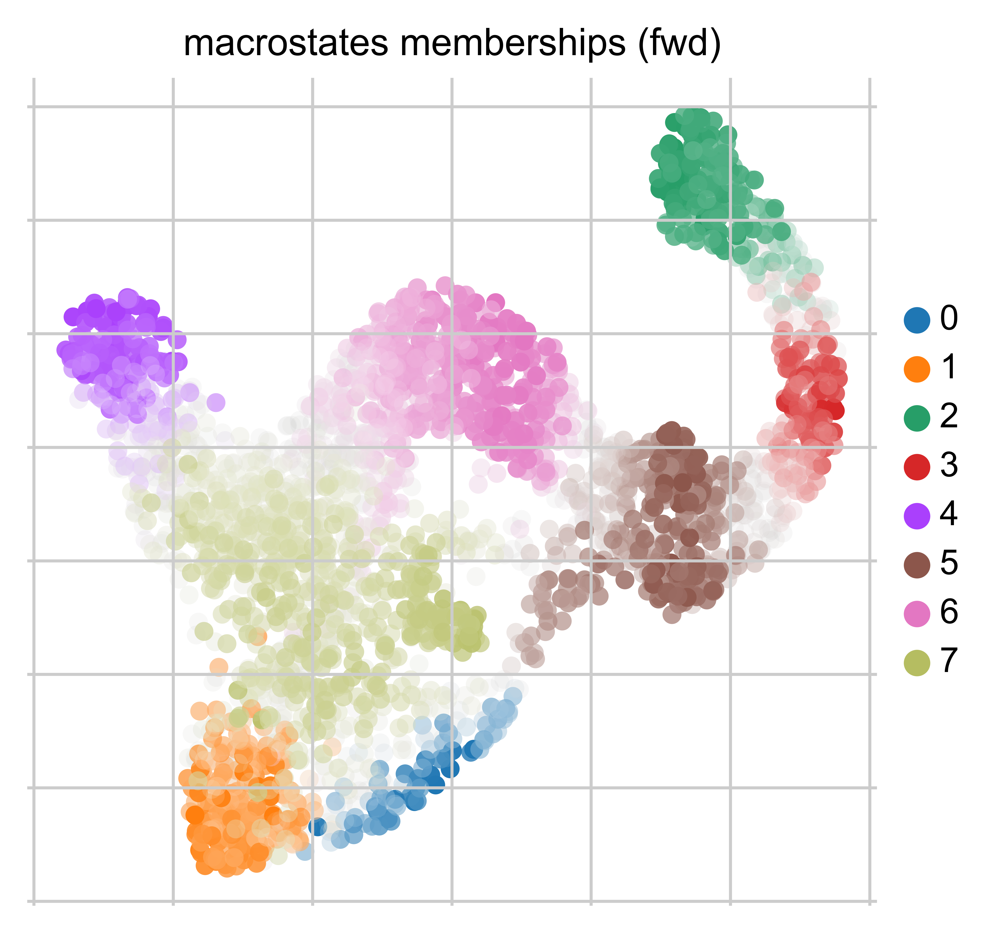

In [42]:
g = cr.tl.estimators.GPCCA(kernel)
g.fit(cluster_key="attractor",n_lineages = 8)
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

In [44]:
dir(g)

['_',
 '_G2M_score',
 '_S_score',
 '__abstractmethods__',
 '__class__',
 '__copy__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__slots__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_abs_prob_key',
 '_absorption_probabilities',
 '_absorption_time_mean',
 '_absorption_time_var',
 '_check_states_validity',
 '_coarse_T',
 '_coarse_init_dist',
 '_coarse_stat_dist',
 '_compute_initial_states',
 '_compute_one_macrostate',
 '_create_states',
 '_detect_cc_stages',
 '_direction',
 '_eig',
 '_fit_terminal_states',
 '_g2m_key',
 '_get',
 '_get_n_states_from_minchi',
 '_gpcca',
 '_invalid_n_states',
 '_is_irreducible',
 '_kernel',
 '_key_added',
 '_lin_abs_times',
 '_lin_drivers',
 '_macrostates',
 '_m

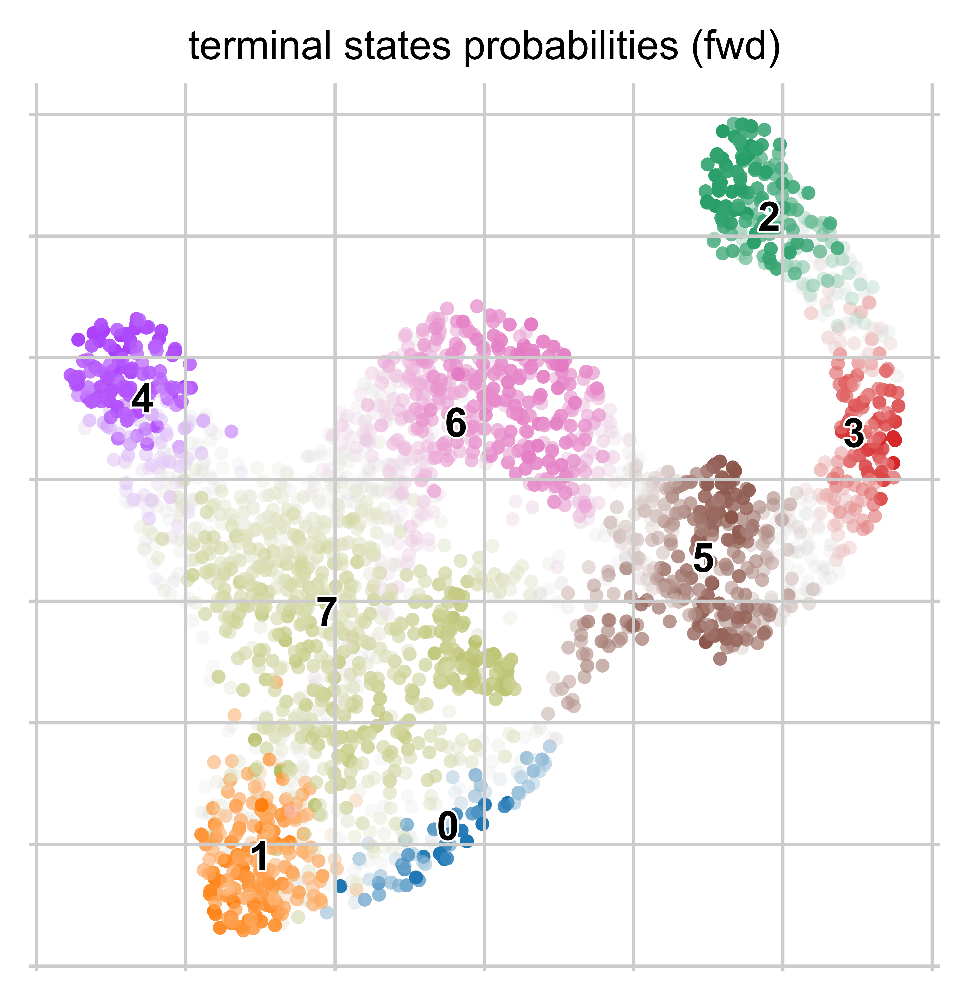

In [53]:
g.compute_terminal_states(method="top_n", n_states=8)
g.plot_terminal_states()

In [55]:
g.compute_absorption_probabilities()

  0%|          | 0/240 [00:00<?, ?/s]

[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger


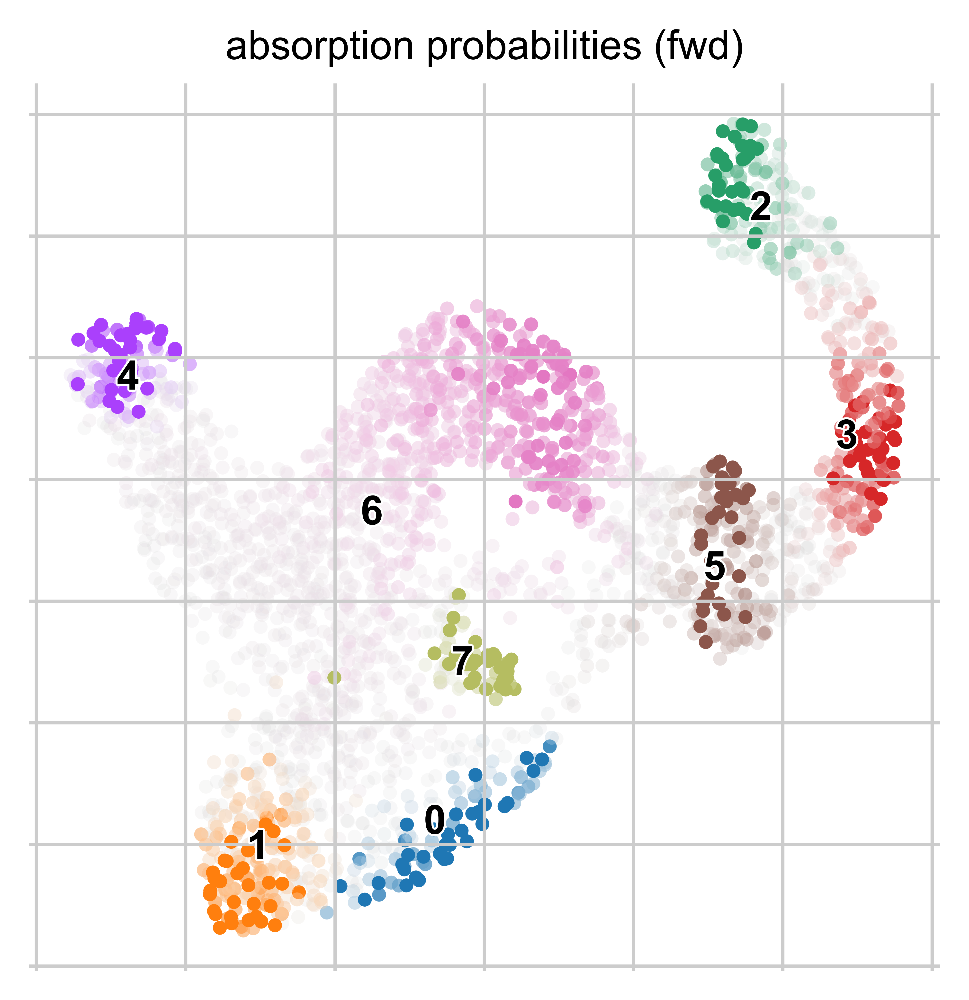

In [56]:
g.plot_absorption_probabilities(same_plot=True)

In [58]:
del adata.uns['r2_keep_train']
del adata.uns['r2_keep_test']
del adata.uns['kernel_connectivities']
del adata.uns['kernel']
adata.write('pancreas_results.h5ad')
adata_aggr.write('pancreas_results_aggr.h5ad')

In [2]:
adata = sc.read_h5ad('pancreas_results.h5ad')
adata_aggr = sc.read_h5ad('pancreas_results_aggr.h5ad')